# Experimentos con Tetrad 7.1.2-2

* Nueva versión 7.1.2-2 de Tetrad
* Grandes mejoras de rendimiento, tanto en tiempo como en puntuación
* Comparación frente a fGES

In [1]:
import warnings
warnings.filterwarnings('ignore')

import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns

import pingouin as pg

pd.options.display.max_info_rows = 30000000

sns.set_theme(style='darkgrid')

# Tamaño figuras
plt.rcParams["figure.figsize"] = (20,8)
plt.rcParams["figure.dpi"] = 600

pd.options.mode.chained_assignment = None

# Paleta de colores tiempo
color = ['#264653', '#2a9d8f', '#e9c46a', '#f4a261', '#e76f51', '#b13c47']

# Paleta de colores BDeu
color2 = ['#264653', '#2a9d8f', '#e9c46a', '#f4a261', '#e76f51', '#b13c47']

# Paleta de colores BDeu sin Fges
color3 = ['#2a9d8f', '#e9c46a', '#f4a261', '#e76f51', '#b13c47']

In [3]:
df = pd.read_csv('results-parallel-5-12-22.csv')
#df['threads'] = pd.Categorical(df.threads)
#df['threadsPGES'] = pd.Categorical(df.threadsPGES)
df['interleaving'] = pd.Categorical(df.interleaving)

df['algorithm'] = df['algorithm'].replace('ges', 'GES')
df['algorithm'] = df['algorithm'].replace('pges', 'pGES')
df['algorithm'] = df['algorithm'].replace('fges', 'Fges')

df2 = pd.read_csv('results-noParallel-6-12-22.csv')
df2['algorithm'] = df2['algorithm'].replace('ges', 'GES-no')
df2['algorithm'] = df2['algorithm'].replace('pges', 'pGES-no')

df = pd.concat([df, df2], ignore_index=True)
df

,algorithm,network,bbdd,threads,threadsPGES,interleaving,seed,SHD,LL Score,BDeu Score,dfMM,dfMM plus,dfMM minus,Total iterations,Total time(s)
0,Fges,alarm,alarm.xbif50001246_,16,0,0,-1,7,0.0,-56600.879830,14.0,0.0,14.0,1,0.979
1,Fges,alarm,alarm.xbif50001246_,1,0,0,-1,7,0.0,-56600.879830,14.0,0.0,14.0,1,2.422
2,Fges,alarm,alarm.xbif50001246_,2,0,0,-1,7,0.0,-56600.879830,14.0,0.0,14.0,1,2.858
3,Fges,alarm,alarm.xbif50001246_,4,0,0,-1,7,0.0,-56600.879830,14.0,0.0,14.0,1,1.037
4,Fges,alarm,alarm.xbif50001246_,8,0,0,-1,7,0.0,-56600.879830,14.0,0.0,14.0,1,1.090
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22358,pGES-no,win95pts,win95pts.xbif_,8,8,15,2,111,0.0,-49954.969398,260.0,82.0,178.0,6,3.264
22359,pGES-no,win95pts,win95pts.xbif_,8,8,20,2,108,0.0,-49935.403974,250.0,80.0,170.0,5,2.750
22360,pGES-no,win95pts,win95pts.xbif_,8,8,30,2,107,0.0,-49805.063378,238.0,66.0,172.0,4,2.821
22361,pGES-no,win95pts,win95pts.xbif_,8,8,50,2,91,0.0,-49545.530560,208.0,54.0,154.0,3,2.633


## Resumen del tiempo de ejecución y el número de experimentos ejecutados

In [4]:
pd.set_option('display.max_rows', 100)
pd.set_option('display.max_columns', 100)
df_unstack = df.drop(["bbdd", "interleaving", "seed", "SHD", "LL Score", "BDeu Score", "dfMM", "dfMM plus", "dfMM minus", "Total iterations"], axis=1)
df_unstack.groupby(["network", "algorithm", "threads", "threadsPGES"], observed=True).mean().unstack(0)

Total time(s)                                  \
network                               alarm      andes    barley      child   
algorithm threads threadsPGES                                                 
Fges      1       0                2.420818   4.845909  8.764182  10.176636   
          2       0                1.987273   7.240000  7.337091   8.661000   
          4       0                1.557636   4.056364  6.491727   6.052273   
          8       0                1.260636   3.412909  5.571909   5.786364   
          16      0                1.170000   3.408909  5.138364   5.446545   
GES       1       0                1.759636  17.487364  2.742091   0.877455   
          2       0                2.388182  24.543000  2.315636   0.948364   
          4       0                2.311818  18.555909  2.027545   1.075000   
          8       0                1.049273  11.615091  1.222545   0.628455   
          16      0                1.070455  11.156545  1.187182   0.628636   
GES-no    1       0                1.186364  72.140000  2.283182   0.748818   
pGES      2       2                3.200299  30.485299  3.106338   1.453377   
                  4                3.108779  25.410883  2.869312   1.577779   
                  8                3.189883  25.781000  2.906377   1.950766   
                  16               3.523117  29.432364  3.376494   2.462143   
          4       2                2.267286  19.193364  2.708519   1.536169   
                  4                2.350727  16.308662  2.695649   1.691519   
                  8                2.368831  18.136130  2.807130   2.025000   
                  16               3.023052  21.570429  3.235597   2.309455   
          8       2                1.220766  13.666701  1.586416   0.833260   
                  4                1.160766  11.901299  1.428623   0.827013   
                  8                1.173065  11.720779  1.463753   0.909623   
                  16               1.275364  14.105169  1.604052   1.105468   
          16      2                1.214416  12.100818  1.539247   0.763844   
                  4                1.155104  10.415584  1.390545   0.775740   
                  8                1.161325  11.064169  1.382714   0.815922   
                  16               1.270195  13.542792  1.524000   0.950753   
pGES-no   2       2                3.301623  45.447618  5.200831   1.653909   
          4       4                1.354844  22.169104  1.684571   0.937481   
          8       8                1.174078  17.336584  1.460143   0.795065   
          16      16               1.195506  21.241909  1.535364   0.861221   

                                                                           \
network                       earthquake   hailfinder    hepar2 insurance   
algorithm threads threadsPGES                                               
Fges      1       0             0.464364  2288.883182  2.454545  1.492545   
          2       0             0.518182  2088.523091  1.666636  1.688909   
          4       0             0.304909  1854.947545  1.122909  1.250818   
          8       0             0.294909  1689.364909  1.123455  0.977364   
          16      0             0.259909  1675.823818  1.081182  0.933636   
GES       1       0             0.495455     2.263909  3.377455  1.437727   
          2       0             0.333818     2.901000  3.540727  1.512182   
          4       0             0.540091     2.753727  2.981727  1.169273   
          8       0             0.248727     1.656091  1.902091  0.748909   
          16      0             0.253364     1.563273  1.855182  0.708909   
GES-no    1       0             0.428273     2.921091  3.787182  1.214545   
pGES      2       2             0.378390     3.693961  4.024117  1.740039   
                  4             0.406026     3.530481  4.365039  1.879026   
                  8                  NaN     3.297117  4.384000  2.133026   
                  16              

In [5]:
df_unstack.groupby(["network", "algorithm", "threads", "threadsPGES"], observed=True).count().unstack(0)

Total time(s)                                \
network                               alarm andes barley child earthquake   
algorithm threads threadsPGES                                               
Fges      1       0                    11.0  11.0   11.0  11.0       11.0   
          2       0                    11.0  11.0   11.0  11.0       11.0   
          4       0                    11.0  11.0   11.0  11.0       11.0   
          8       0                    11.0  11.0   11.0  11.0       11.0   
          16      0                    11.0  11.0   11.0  11.0       11.0   
GES       1       0                    11.0  11.0   11.0  11.0       11.0   
          2       0                    11.0  11.0   11.0  11.0       11.0   
          4       0                    11.0  11.0   11.0  11.0       11.0   
          8       0                    11.0  11.0   11.0  11.0       11.0   
          16      0                    11.0  11.0   11.0  11.0       11.0   
GES-no    1       0                    11.0  11.0   11.0  11.0       11.0   
pGES      2       2                    77.0  77.0   77.0  77.0       77.0   
                  4                    77.0  77.0   77.0  77.0       77.0   
                  8                    77.0  77.0   77.0  77.0        NaN   
                  16                   77.0  77.0   77.0  77.0        NaN   
          4       2                    77.0  77.0   77.0  77.0       77.0   
                  4                    77.0  77.0   77.0  77.0       77.0   
                  8                    77.0  77.0   77.0  77.0        NaN   
                  16                   77.0  77.0   77.0  77.0        NaN   
          8       2                    77.0  77.0   77.0  77.0       77.0   
                  4                    77.0  77.0   77.0  77.0       77.0   
                  8                    77.0  77.0   77.0  77.0        NaN   
                  16                   77.0  77.0   77.0  77.0        NaN   
          16      2                    77.0  77.0   77.0  77.0       77.0   
                  4                    77.0  77.0   77.0  77.0       77.0   
                  8                    77.0  77.0   77.0  77.0        NaN   
                  16                   77.0  77.0   77.0  77.0        NaN   
pGES-no   2       2                    77.0  76.0   77.0  77.0       77.0   
          4       4                    77.0  77.0   77.0  77.0       77.0   
          8       8                    77.0  77.0   77.0  77.0        NaN   
          16      16                   77.0  77.0   77.0  77.0        NaN   

                                                                              \
network                       hailfinder hepar2 insurance  link mildew munin   
algorithm threads threadsPGES                                                  
Fges      1       0                 11.0   11.0      11.0  11.0    NaN  11.0   
          2       0                 11.0   11.0      11.0  11.0    NaN  11.0   
          4       0                 11.0   11.0      11.0  11.0    NaN  11.0   
          8       0                 11.0   11.0      11.0  11.0    NaN  11.0   
          16      0                 11.0   11.0      11.0  11.0    NaN  11.0   
GES       1       0                 11.0   11.0      11.0  11.0   11.0  10.0   
          2       0                 11.0   11.0      11.0  11.0   11.0   8.0   
          4       0                 11.0   11.0      11.0  11.0   11.0  11.0   
          8       0                 11.0   11.0      11.0  11.0   11.0  11.0   
          16      0                 11.0   11.0      11.0  11.0   11.0  11.0   
GES-no    1       0                 11.0   11.0      11.0  11.0   11.0  11.0   
pGES      2       2                 77.0   77.0      77.0  76.0   77.0  76.0   
                  4                 77.0   77.0      77.0  76.0   77.0  72.0   
                  8                 77.0   77.0      77.0  74.0   77.0  69.0   
                  16                77.0   77.0    

In [6]:
# create a column with True if the algorithm is GES-no or pGES-no
df['nuevo'] = np.where(((df['algorithm']=='GES-no')|(df['algorithm']=='pGES-no')|(df['algorithm']=='Fges')), False, True)

# in GES-no and pGES-no, the number of threads is 0
df['threads'] = np.where(((df['algorithm']=='GES-no')|(df['algorithm']=='pGES-no')), 0, df["threads"])

df['alg'] = np.where(((df['algorithm']=='pGES')|(df['algorithm']=='pGES-no')), 'pGES' + ' ' + df["threadsPGES"].astype(str), df["algorithm"])
df['alg'] = np.where(((df['alg']=='GES-no')), 'GES', df["alg"])

df = df.sort_values(by=['threadsPGES'])

## Gráficas comparativas con GES y pGES "tradicionales"

In [7]:
def plot(network, variable, precision, size, removeFges=False):    
    df_temp = df[df["network"] == network]
    
    # only df nuevo = False o algorithm = fGES
    df_temp = df_temp[(df_temp["nuevo"] == False) | (df_temp["algorithm"] == "Fges")]
        
    paleta = color2
    if removeFges:
        df_temp = df_temp[df_temp["algorithm"] != "Fges"]
        if variable == "BDeu Score" or variable == "SHD":
            paleta = color3
    
    # Order of the bars: fges, ges, pges
    if removeFges:
        order = ["GES", "pGES 2", "pGES 4", "pGES 8", "pGES 16"]
    else:
        order = ["Fges", "GES", "pGES 2", "pGES 4", "pGES 8", "pGES 16"]

    # Gráfico de barras, sin leyenda (se crea después)
    if variable == "BDeu Score":
        ax = sns.barplot(data=df_temp, x="alg", y=variable, ci=None, palette=paleta, order=order)
        min = df_temp[variable].min()*1.01
        max = df_temp[variable].max()*0.93
        ax.set_ylim(min, max)
        texto = "BDeu:  " + network
    elif variable == "SHD":
        ax = sns.barplot(data=df_temp, x="alg", y=variable, ci=None, palette=paleta, order=order)
        texto = "SHD:  " + network
    elif variable == "Total time(s)":
        ax = sns.barplot(data=df_temp, x="alg", y=variable, hue='threads', ci=None, palette=color, order=order)
        texto = "tiempo:  " + network

        for i in range(6):
            ax.patches[i].set_color(color[i]) 
            ax.patches[i].set_edgecolor('white')

    ax.set_title('Comparativa ' + texto, fontsize=16)
    ax.set_xlabel('Algoritmo', fontsize=14)
    ax.set_ylabel(variable, fontsize=14)

    # Imprimir valores de las barras en la parte superior
    for p in ax.patches:
        if not np.isnan(p.get_height()):
            altura = p.get_height()
            if variable == "BDeu Score":
                altura -= (max-min)*0.03

            # Imprimir valores de las barras en la parte inferior
            ax.text(p.get_x() + p.get_width()/2., altura, ('{0:.'+str(precision)+'f}').format(p.get_height()), ha='center', va='bottom', fontsize=size) 
    
    # Rotar labels inferiores
    plt.xticks(rotation=45)
        
    plt.plot

### Hailfinder

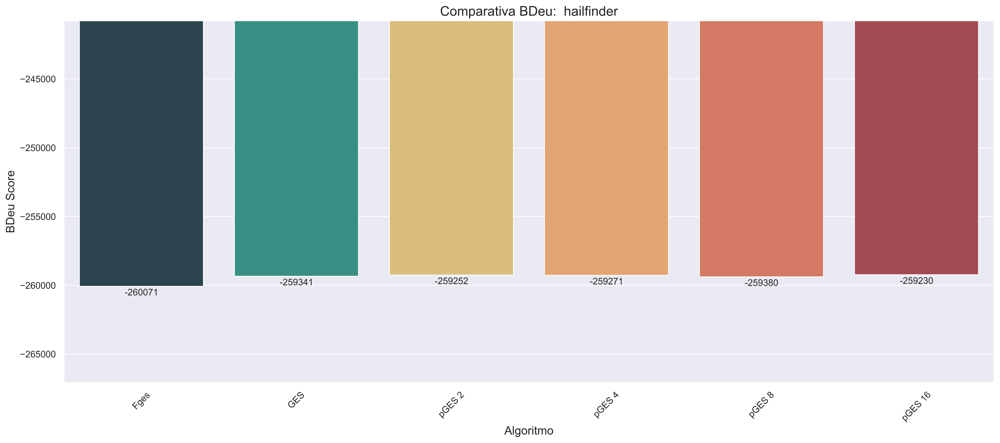

In [397]:
plot("hailfinder", "BDeu Score", 0, 11)

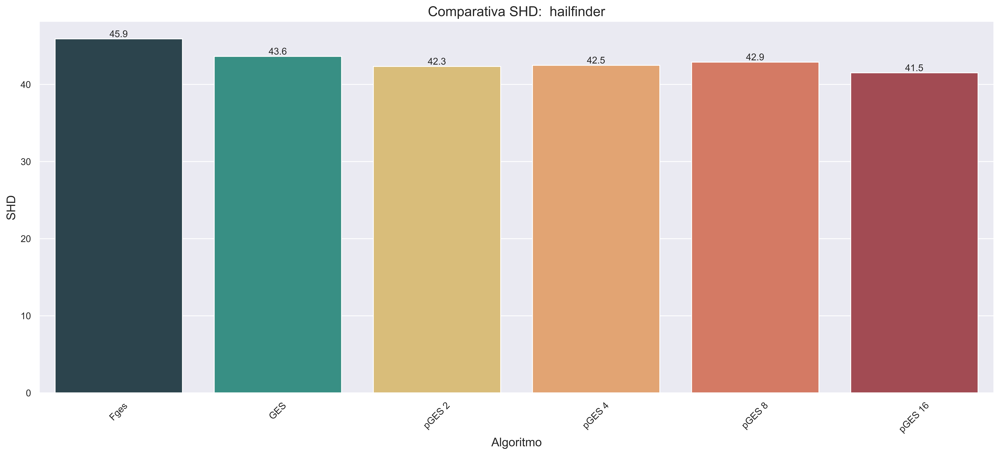

In [398]:
plot("hailfinder", "SHD", 1, 11)

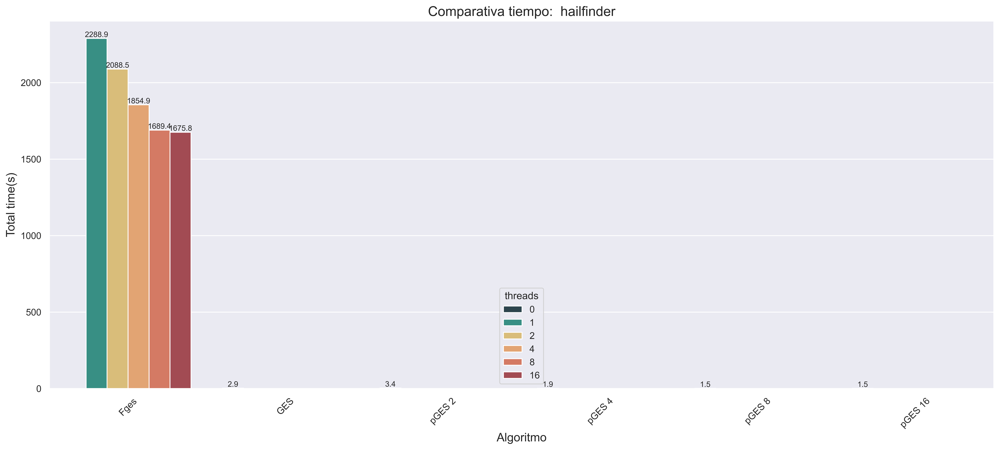

In [399]:
plot("hailfinder", "Total time(s)", 1, 9)

### Andes

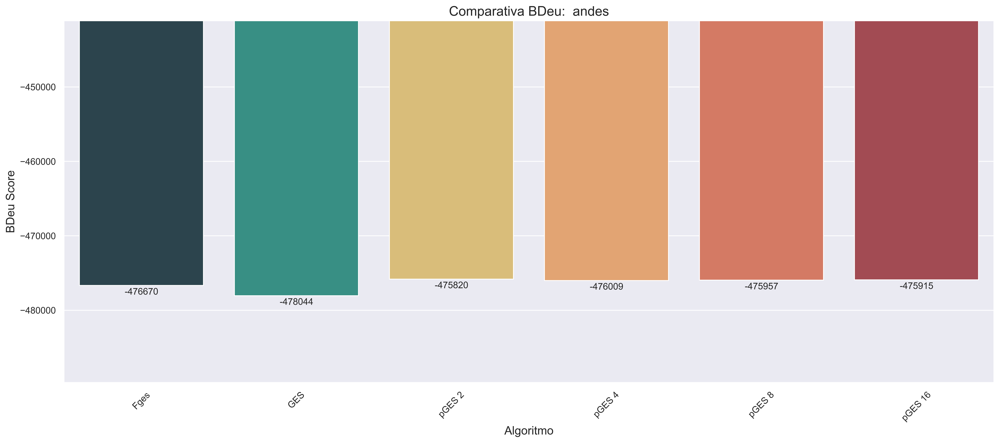

In [400]:
plot("andes", "BDeu Score", 0, 11)

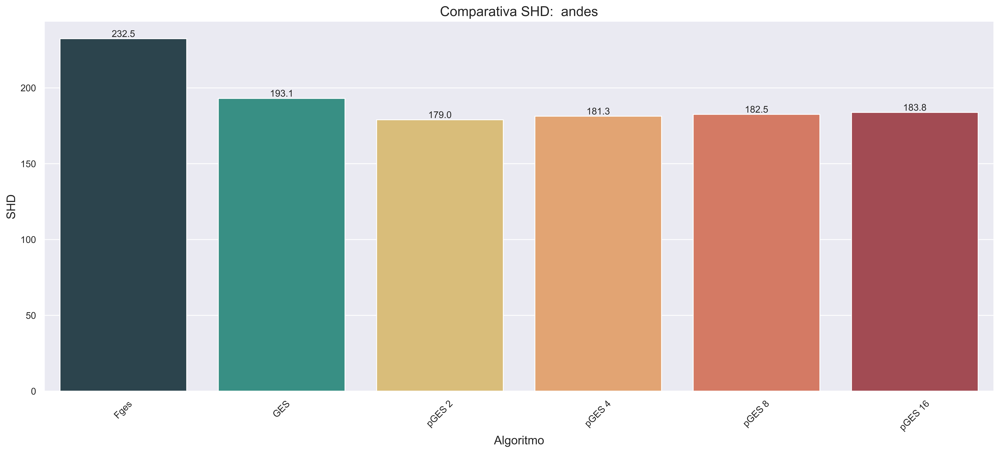

In [401]:
plot("andes", "SHD", 1, 11)

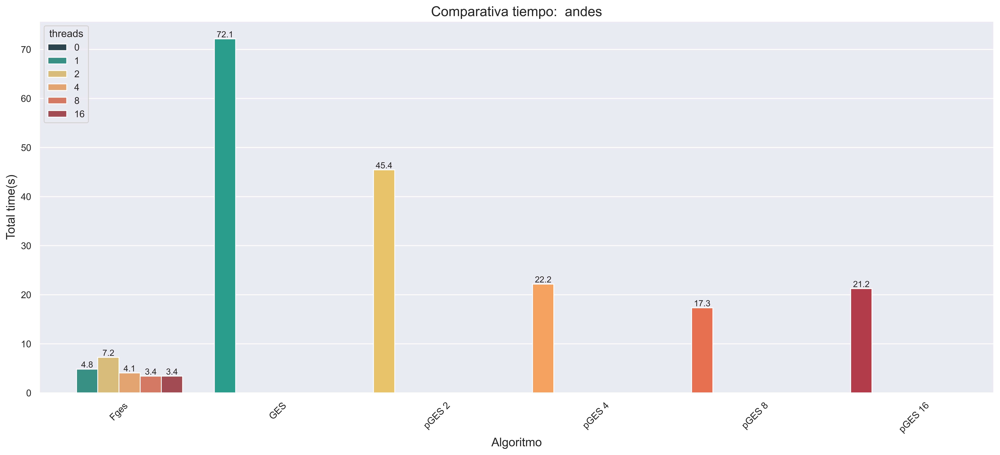

In [402]:
plot("andes",  "Total time(s)", 1, 10)

### Pigs

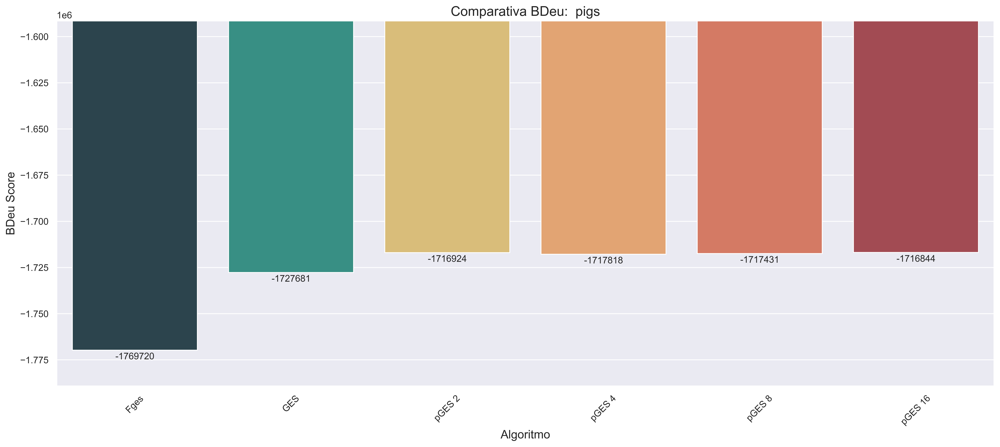

In [403]:
plot("pigs", "BDeu Score", 0, 11)

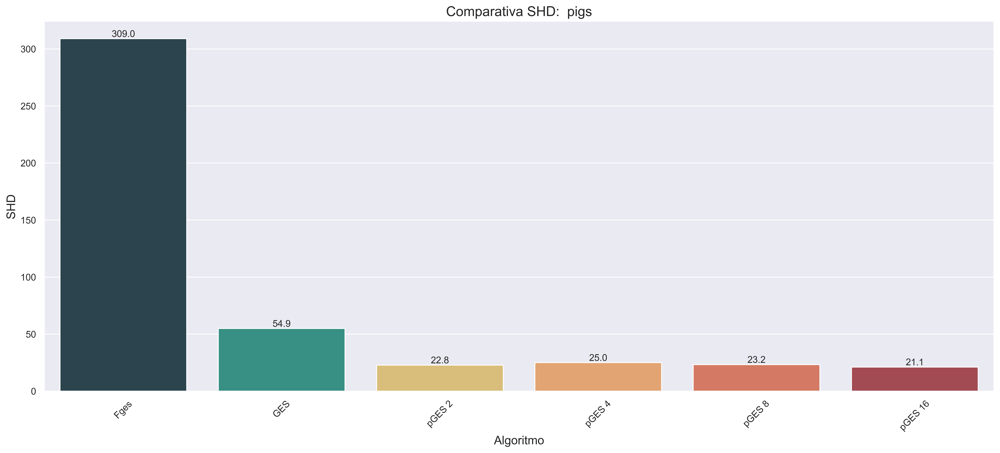

In [404]:
plot("pigs", "SHD", 1, 11)

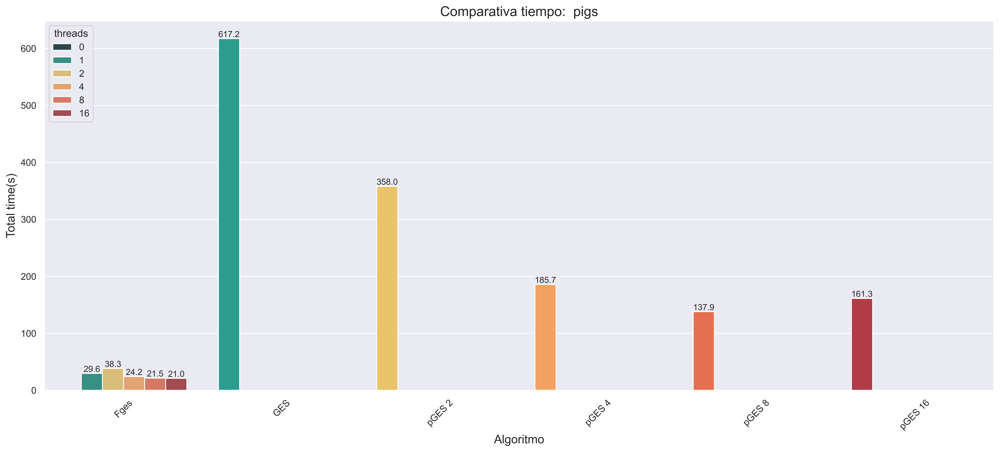

In [405]:
plot("pigs",  "Total time(s)", 1, 10)

### Link

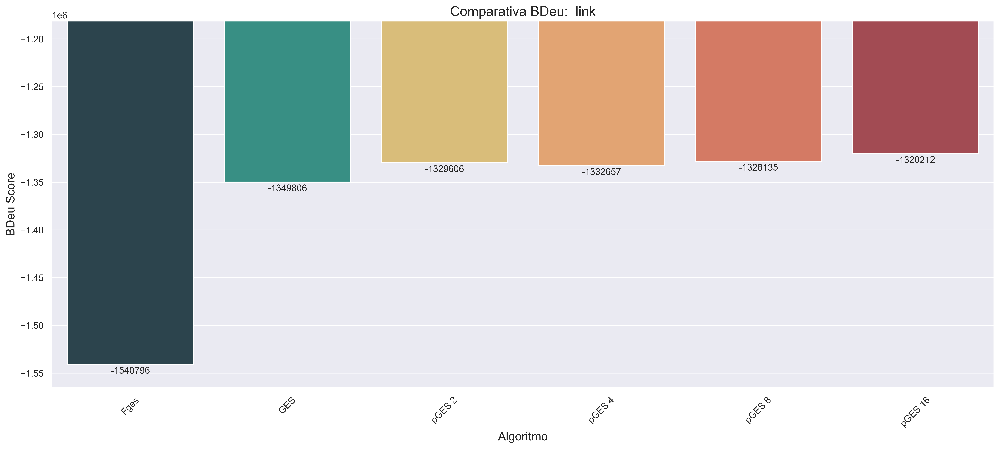

In [406]:
plot("link", "BDeu Score", 0, 11)

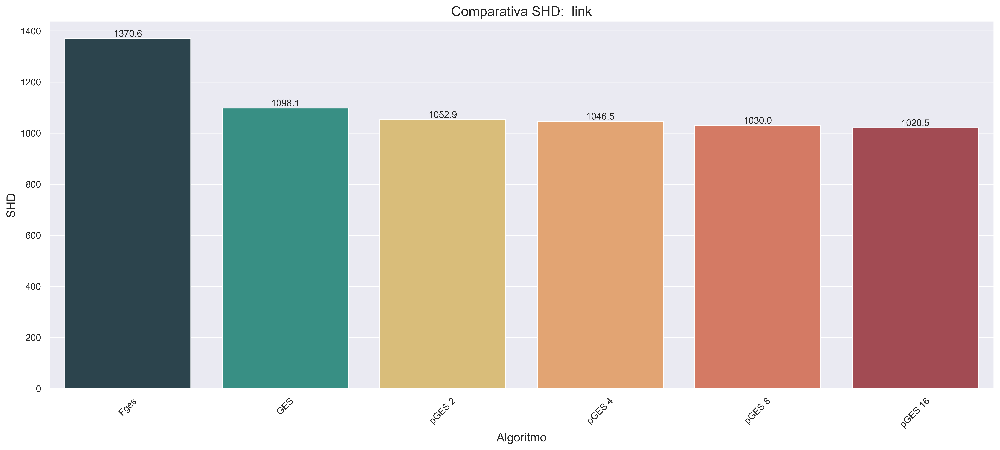

In [407]:
plot("link", "SHD", 1, 11)

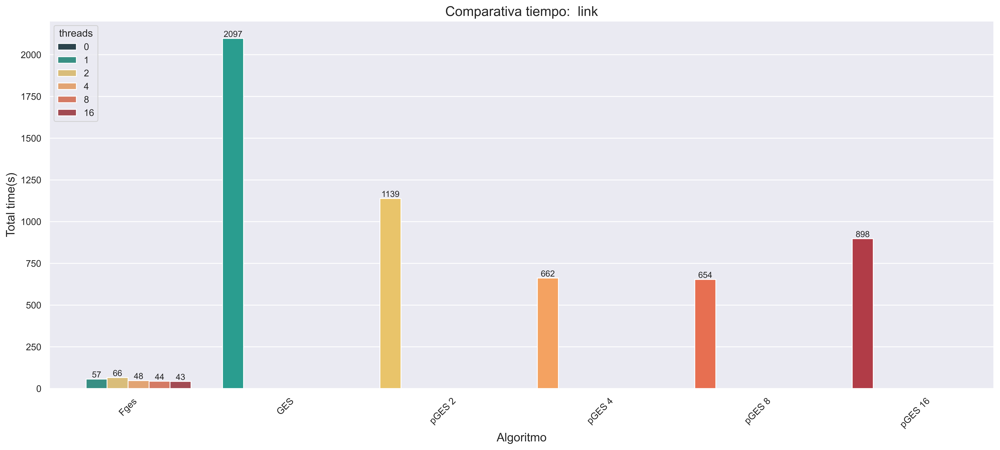

In [408]:
plot("link",  "Total time(s)", 0, 10)

### Munin

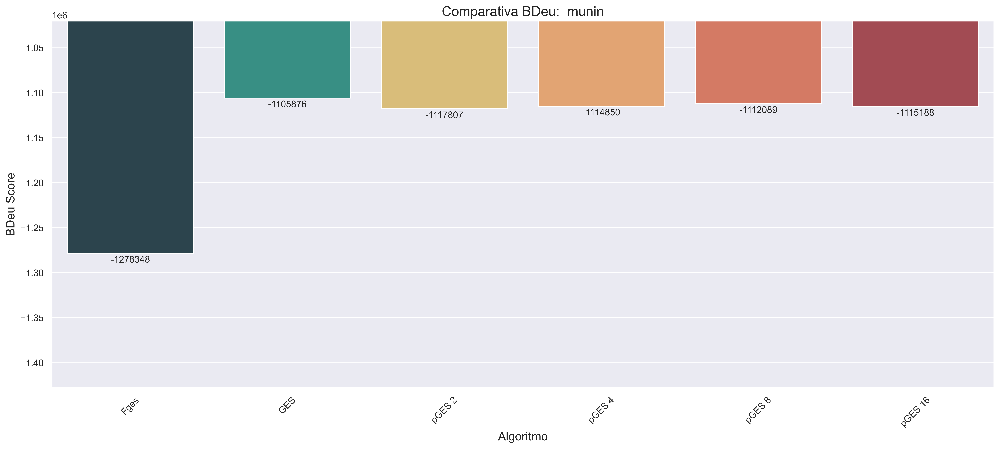

In [409]:
plot("munin", "BDeu Score", 0, 11)

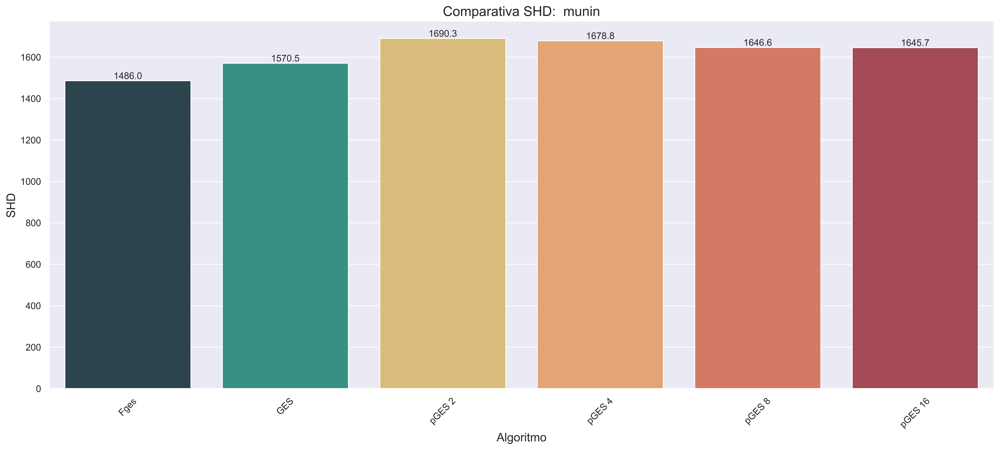

In [410]:
plot("munin", "SHD", 1, 11)

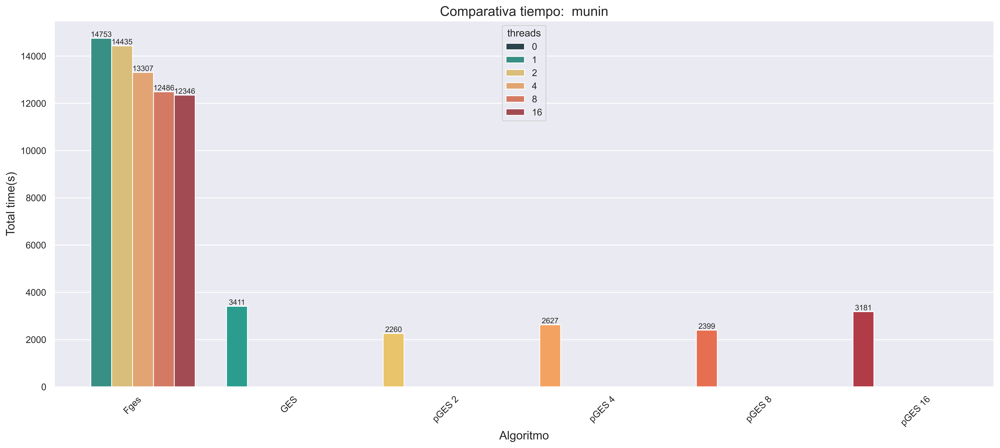

In [411]:
plot("munin",  "Total time(s)", 0, 9)

## Gráficas comparativas "nuevos" vs fGES

In [412]:
def plot(network, variable, precision, size, removeFges=False):    
    df_temp = df[df["network"] == network]
    
    paleta = color2
    if removeFges:
        df_temp = df_temp[df_temp["algorithm"] != "Fges"]
        if variable == "BDeu Score" or variable == "SHD":
            paleta = color3
    
    # Order of the bars: fges, ges, pges
    if removeFges:
        order = ["GES", "pGES 2", "pGES 4", "pGES 8", "pGES 16"]
        n = 5
    else:
        order = ["Fges", "GES", "pGES 2", "pGES 4", "pGES 8", "pGES 16"]
        n = 6

    # Gráfico de barras, sin leyenda (se crea después)
    if variable == "BDeu Score":
        ax = sns.barplot(data=df_temp, x="alg", y=variable, hue='nuevo', ci=None, palette=paleta, order=order)
        min = df_temp[variable].min()*1.01
        max = df_temp[variable].max()*0.93
        ax.set_ylim(min, max)
        texto = "BDeu:  " + network
    elif variable == "SHD":
        ax = sns.barplot(data=df_temp, x="alg", y=variable, hue='nuevo', ci=None, palette=paleta, order=order)
        texto = "SHD:  " + network
    elif variable == "Total time(s)":
        ax = sns.barplot(data=df_temp, x="alg", y=variable, hue='threads', ci=None, palette=color, order=order)
        texto = "tiempo:  " + network

        for i in range(n):
            if (n == 6):
                ax.patches[i].set_color(color[i]) 
            else:
                ax.patches[i].set_color(color3[i]) 
            ax.patches[i].set_edgecolor('white')

    ax.set_title('Comparativa ' + texto, fontsize=16)
    ax.set_xlabel('Algoritmo', fontsize=14)
    ax.set_ylabel(variable, fontsize=14)

    # Imprimir valores de las barras en la parte superior
    for p in ax.patches:
        if not np.isnan(p.get_height()):
            altura = p.get_height()
            if variable == "BDeu Score":
                altura -= (max-min)*0.03

            # Imprimir valores de las barras en la parte inferior
            ax.text(p.get_x() + p.get_width()/2., altura, ('{0:.'+str(precision)+'f}').format(p.get_height()), ha='center', va='bottom', fontsize=size) 
    
    # Rotar labels inferiores
    plt.xticks(rotation=45)
        
    plt.plot

### Hailfinder

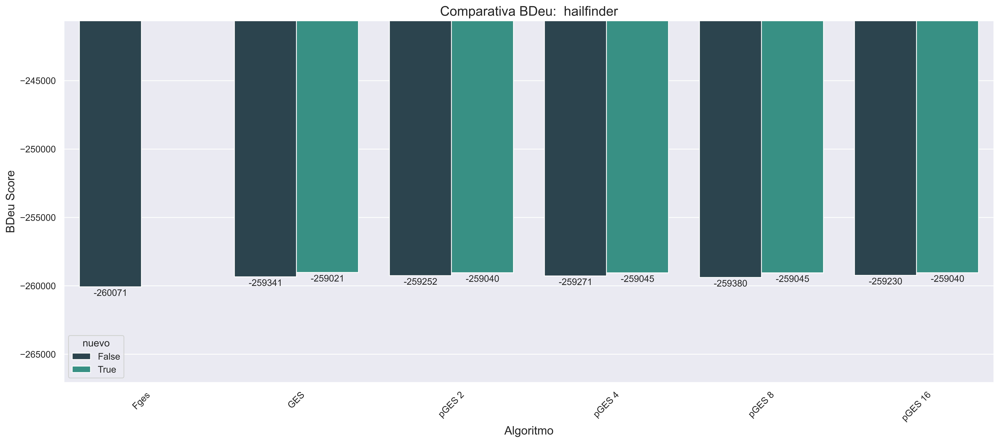

In [413]:
plot("hailfinder", "BDeu Score", 0, 11)

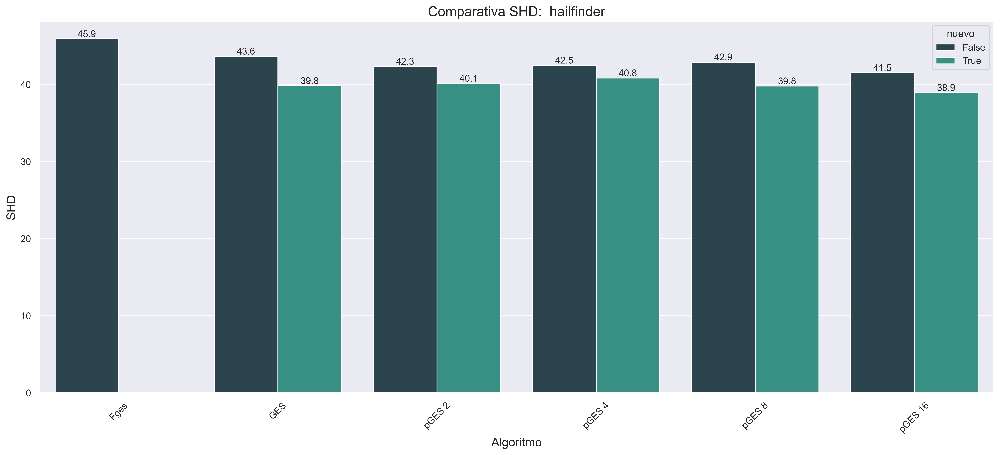

In [414]:
plot("hailfinder", "SHD", 1, 11)

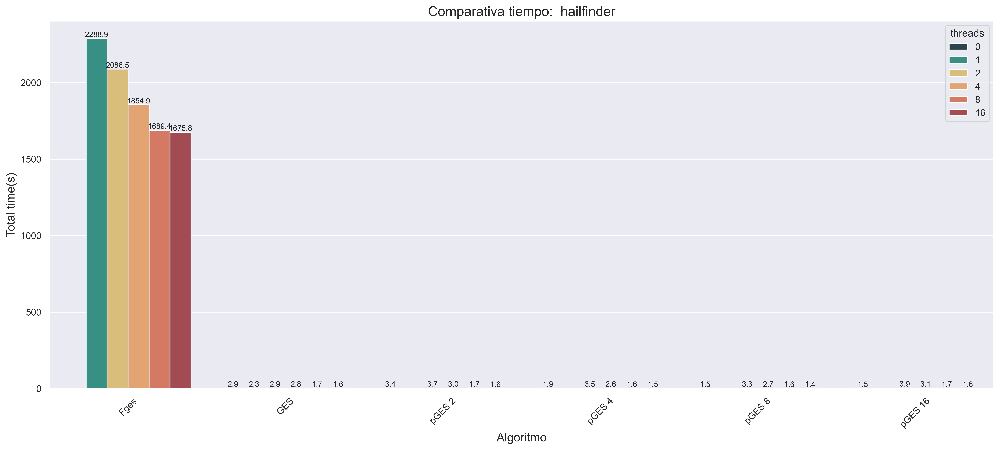

In [415]:
plot("hailfinder", "Total time(s)", 1, 9)

### Andes

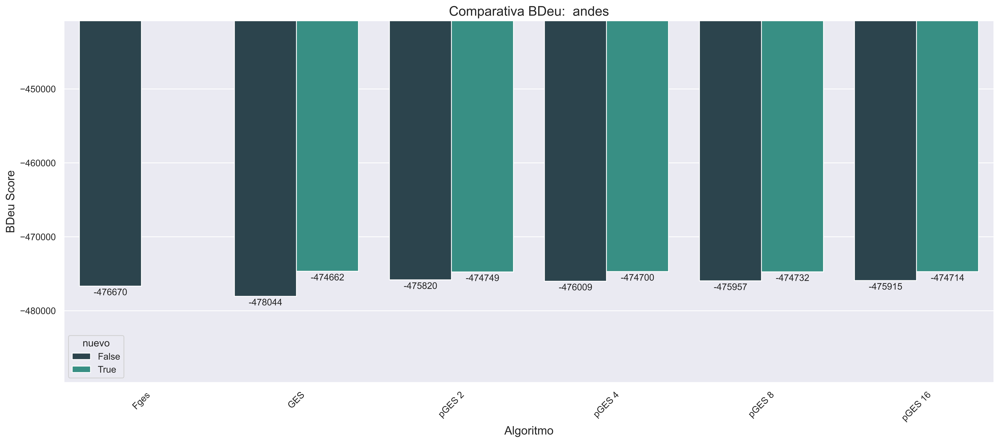

In [416]:
plot("andes", "BDeu Score", 0, 11)

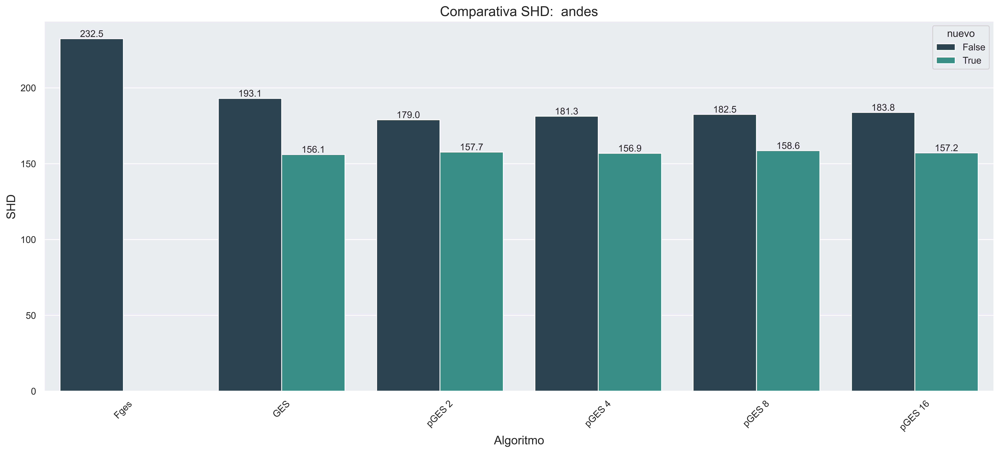

In [417]:
plot("andes", "SHD", 1, 11)

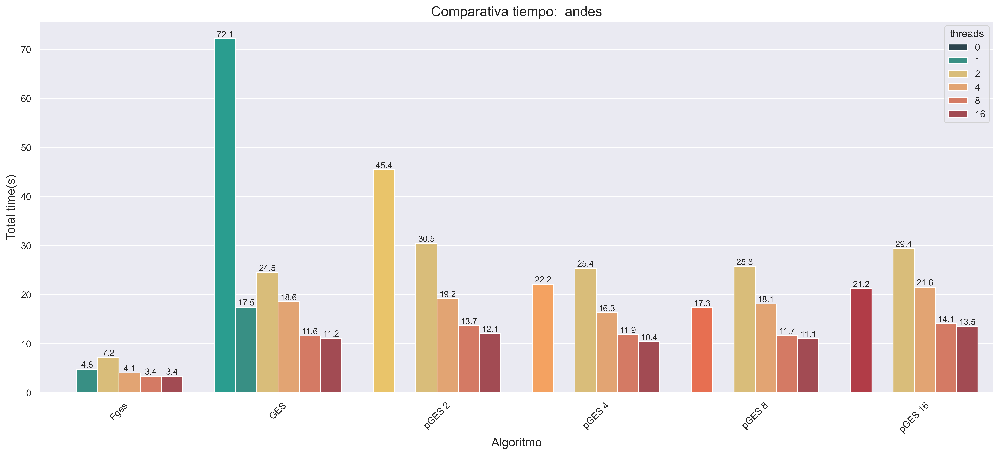

In [418]:
plot("andes",  "Total time(s)", 1, 10)

### Pigs

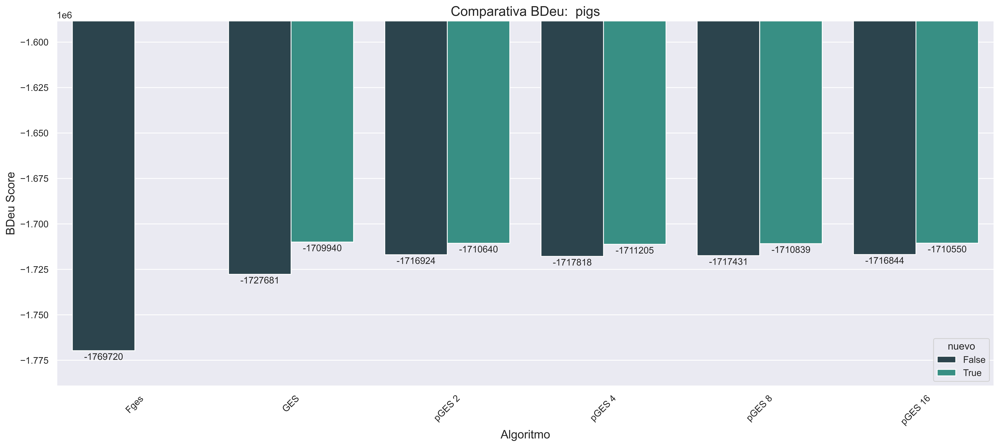

In [419]:
plot("pigs", "BDeu Score", 0, 11)

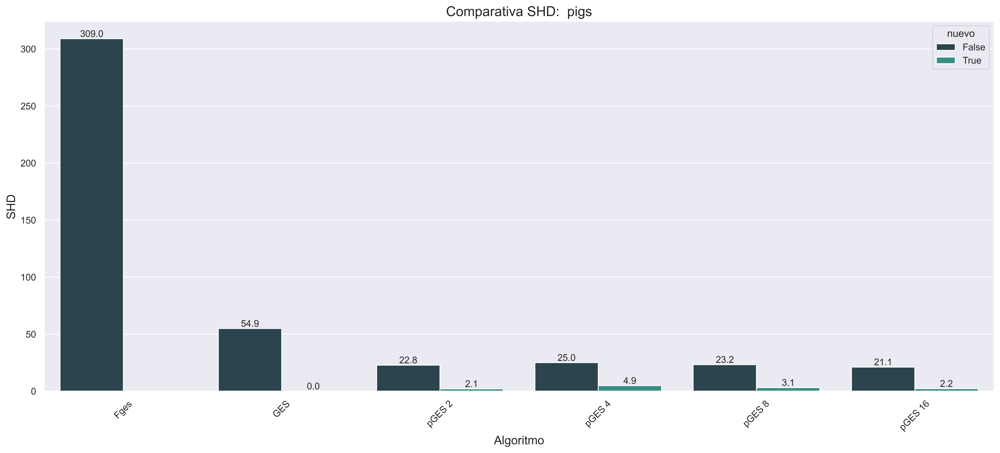

In [420]:
plot("pigs", "SHD", 1, 11)

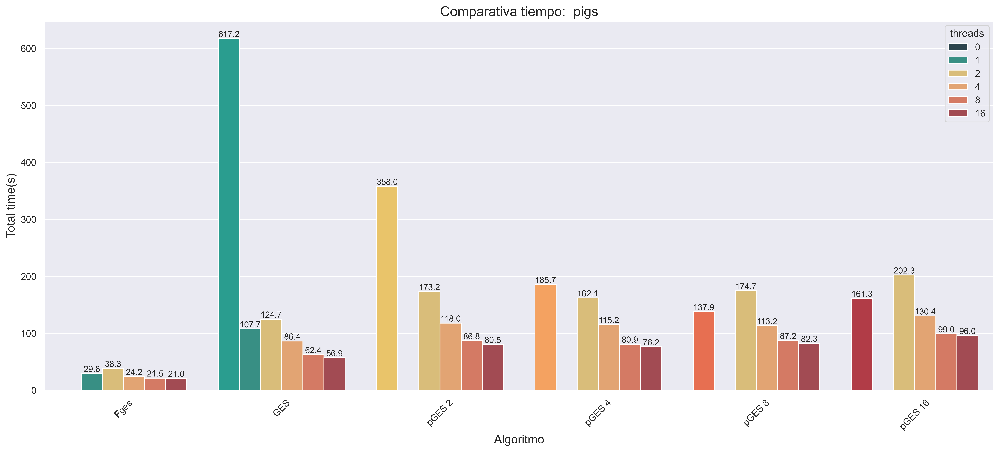

In [421]:
plot("pigs",  "Total time(s)", 1, 10)

### Link

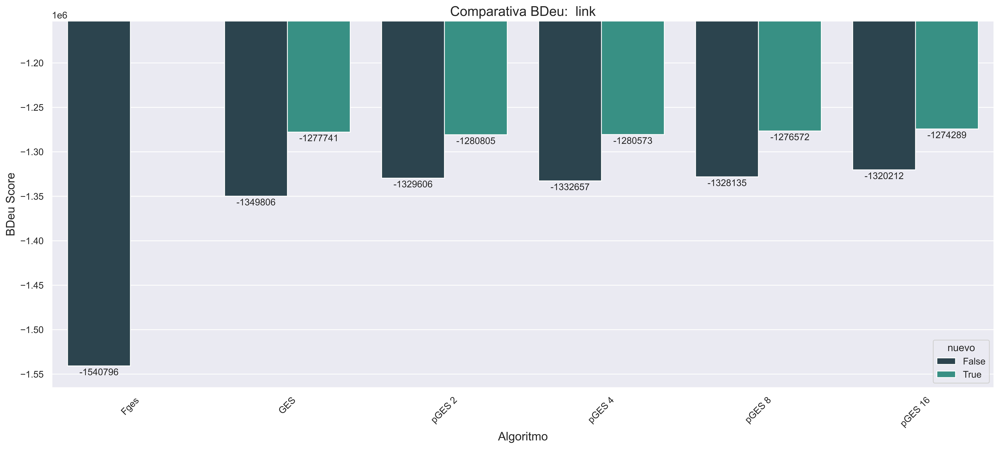

In [422]:
plot("link", "BDeu Score", 0, 11)

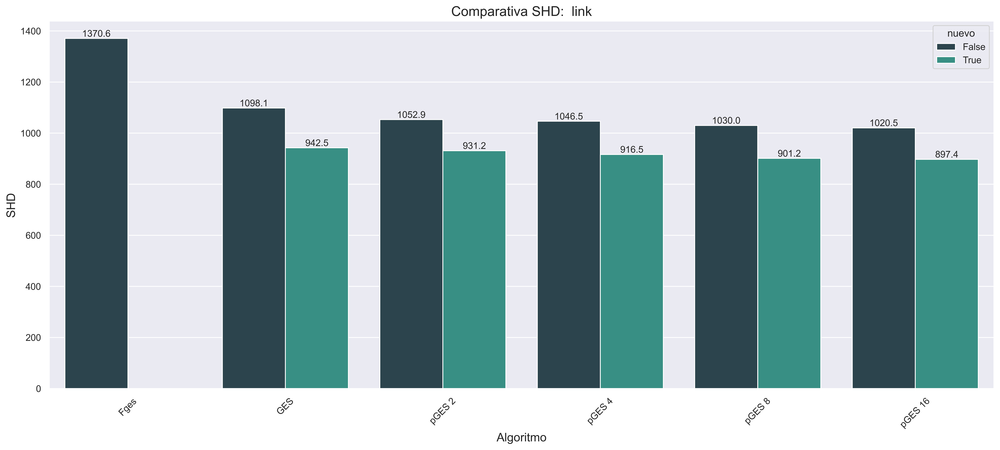

In [423]:
plot("link", "SHD", 1, 11)

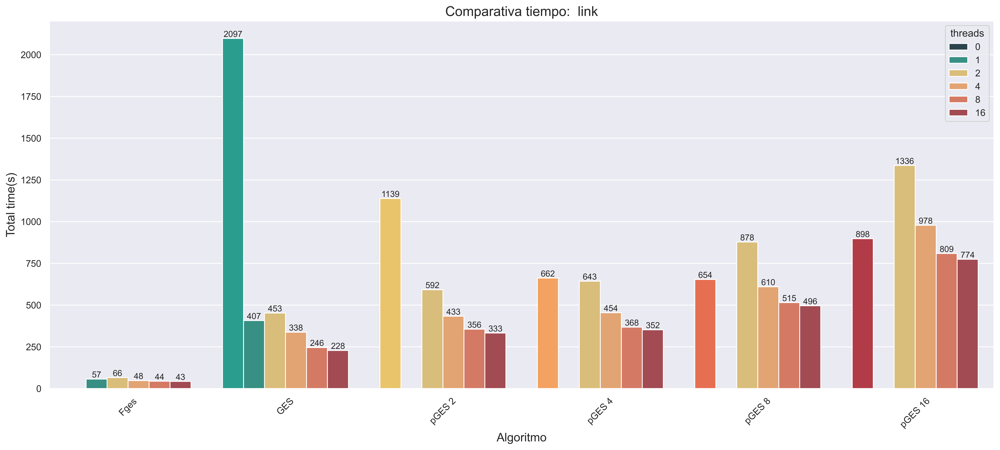

In [424]:
plot("link",  "Total time(s)", 0, 10)

### Munin

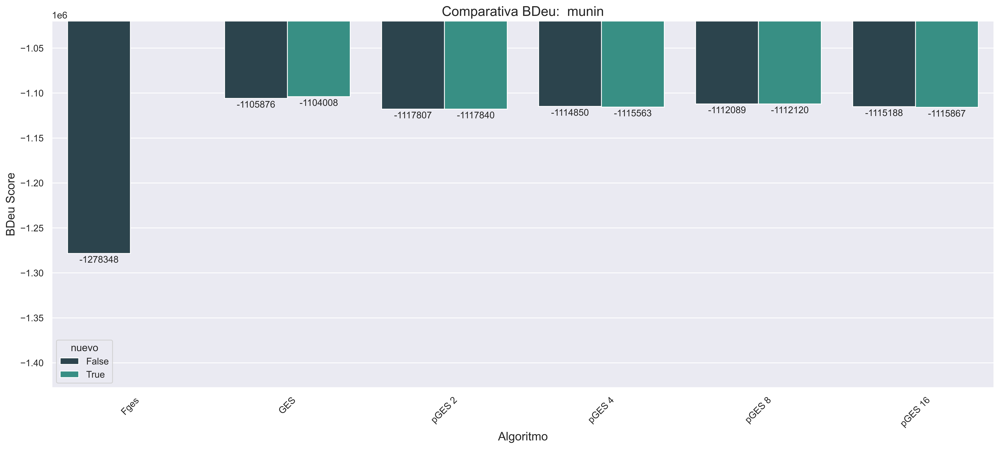

In [425]:
plot("munin", "BDeu Score", 0, 11)

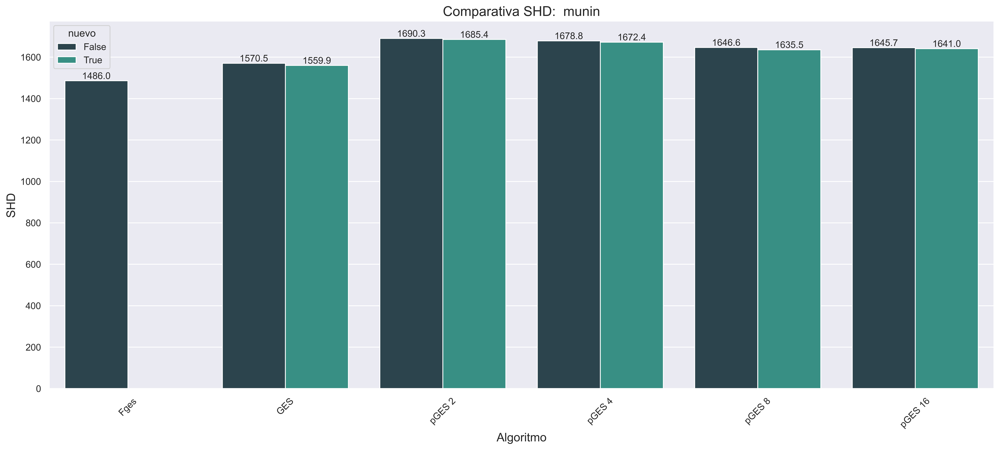

In [426]:
plot("munin", "SHD", 1, 11)

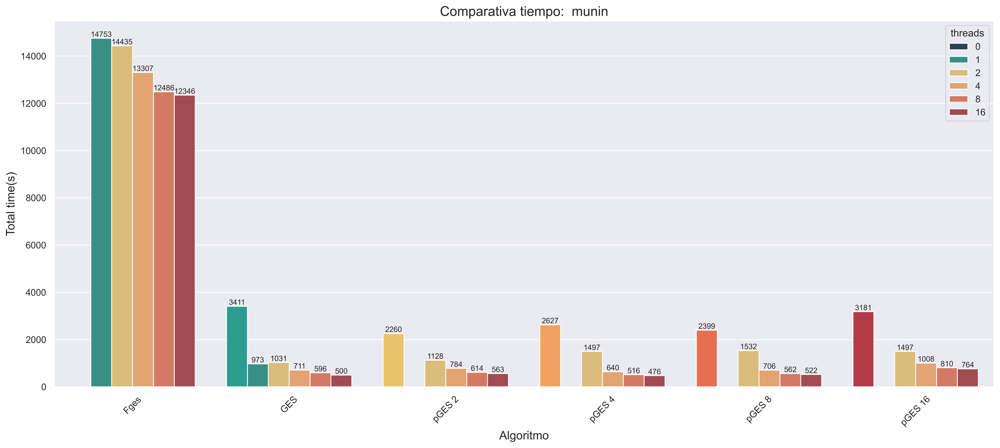

In [427]:
plot("munin",  "Total time(s)", 0, 9)

## Comparación GES vs pGES "nuevos"

### Andes

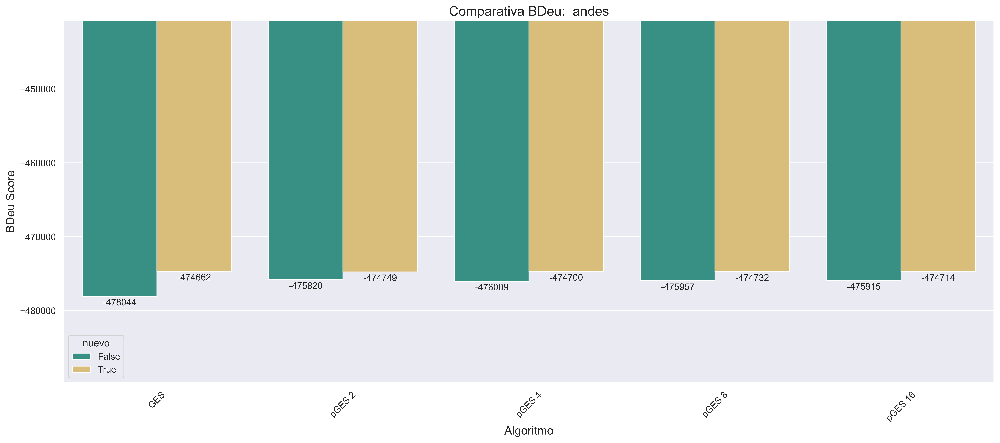

In [428]:
plot("andes", "BDeu Score", 0, 11, True)

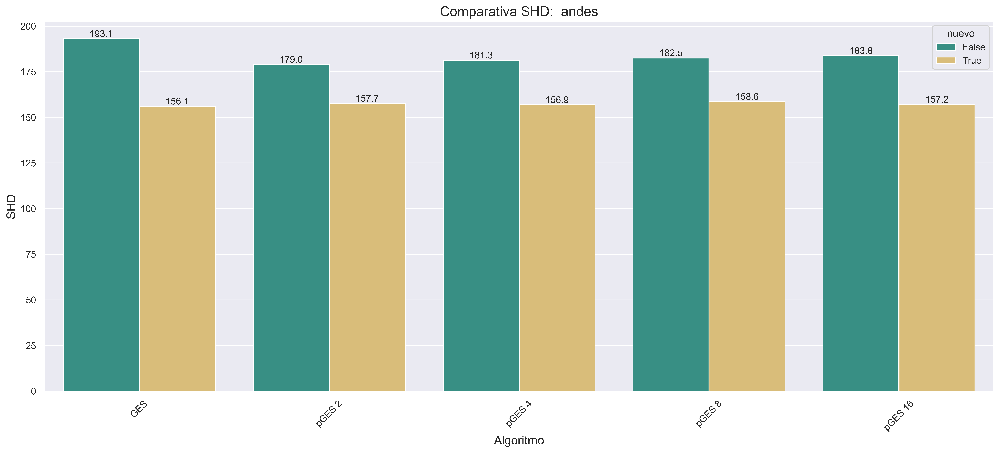

In [429]:
plot("andes", "SHD", 1, 11, True)

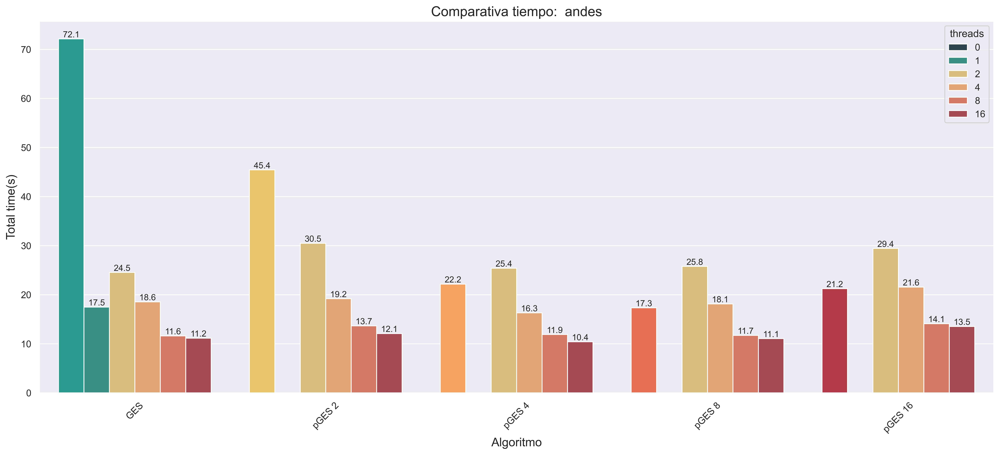

In [430]:
plot("andes",  "Total time(s)", 1, 10, True)

### Pigs

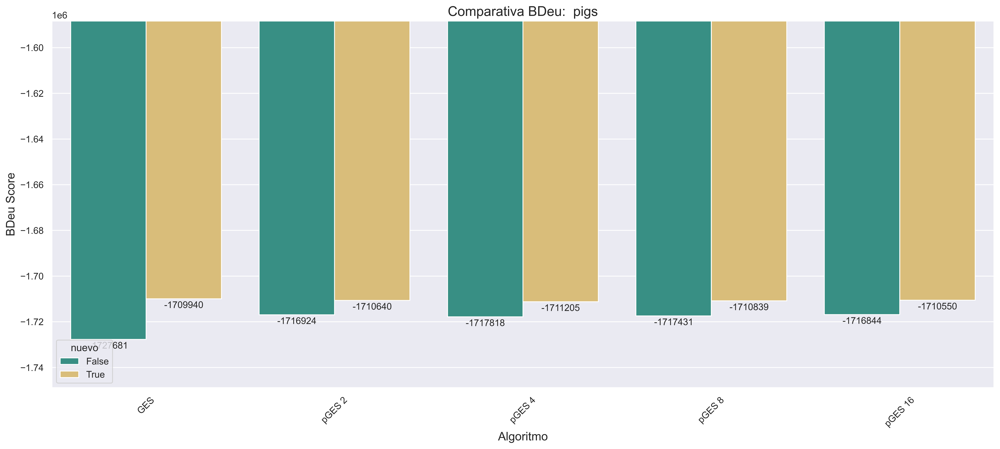

In [431]:
plot("pigs", "BDeu Score", 0, 11, True)

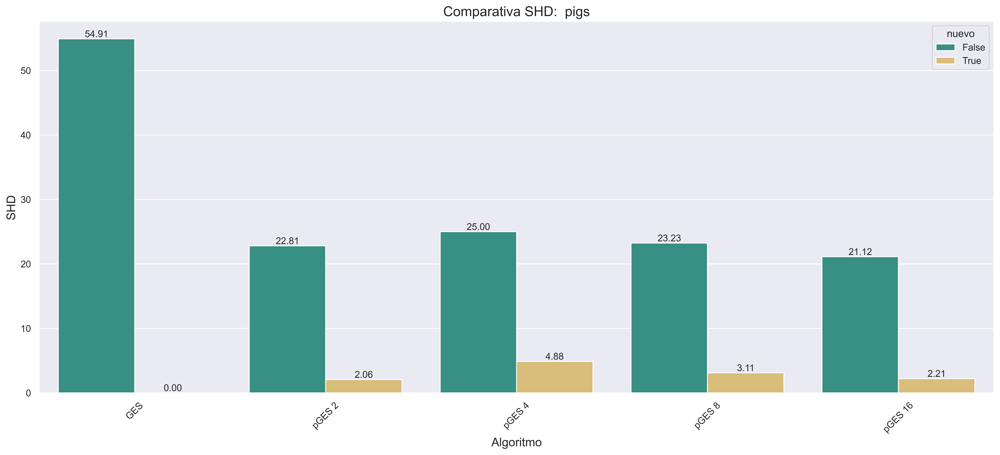

In [432]:
plot("pigs", "SHD", 2, 11, True)

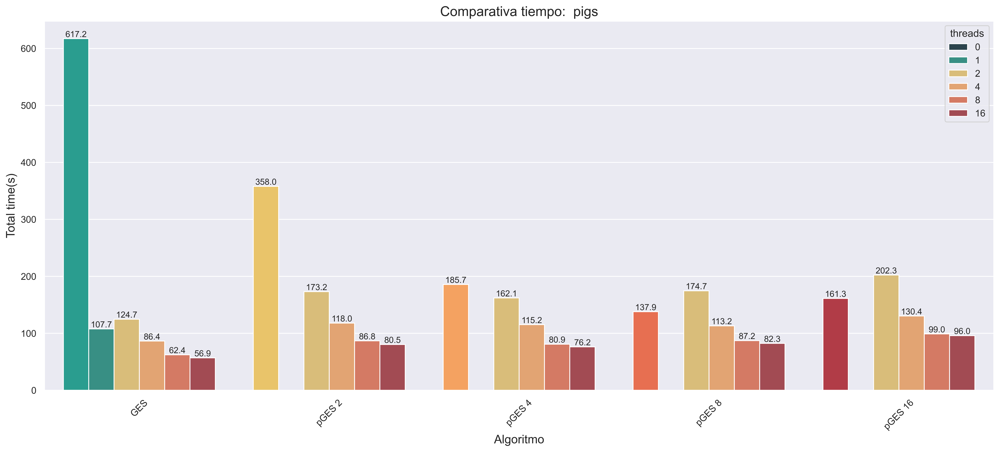

In [433]:
plot("pigs",  "Total time(s)", 1, 10, True)

### Link

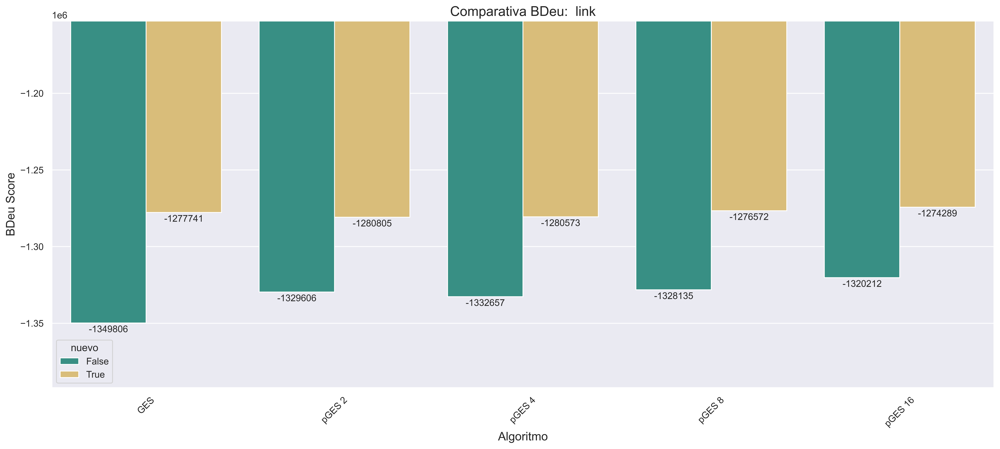

In [434]:
plot("link", "BDeu Score", 0, 11, True)

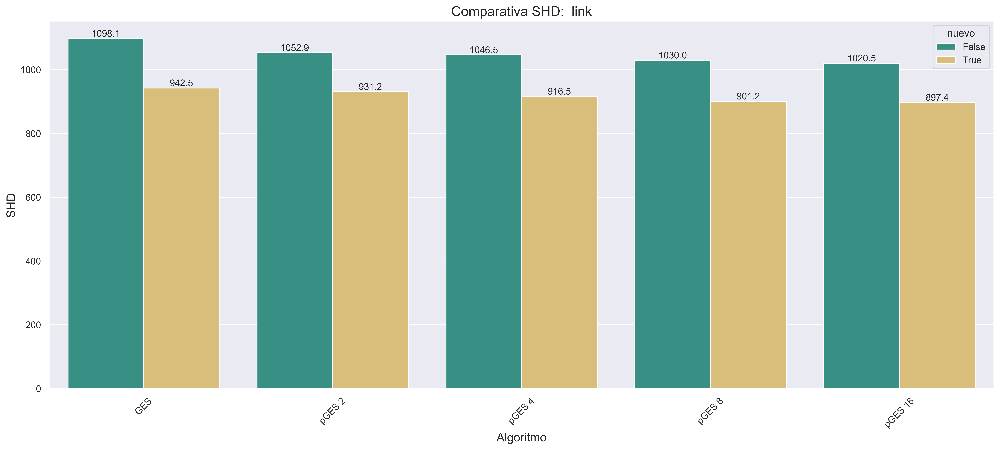

In [435]:
plot("link", "SHD", 1, 11, True)

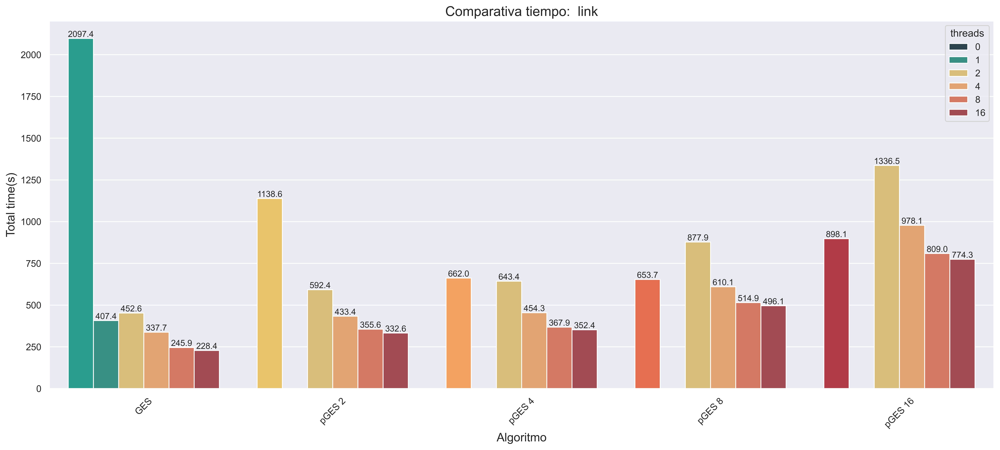

In [436]:
plot("link",  "Total time(s)", 1, 10, True)

### Munin

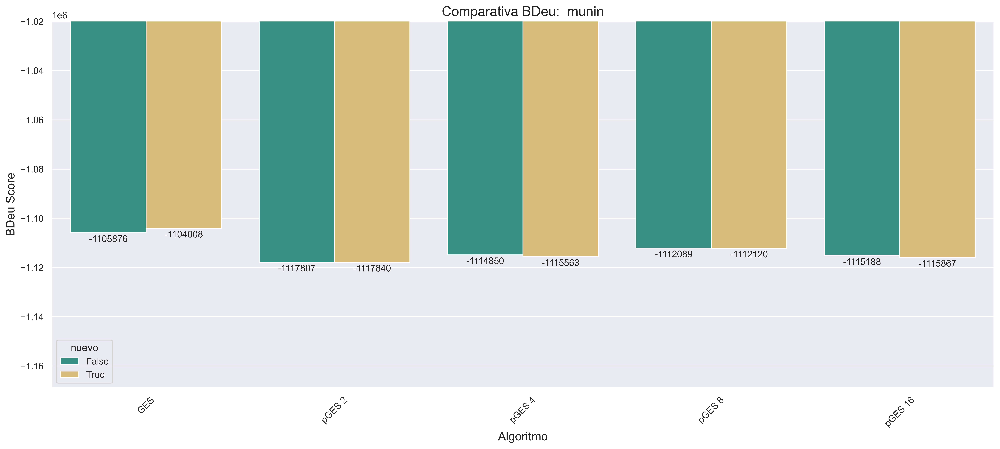

In [437]:
plot("munin", "BDeu Score", 0, 11, True)

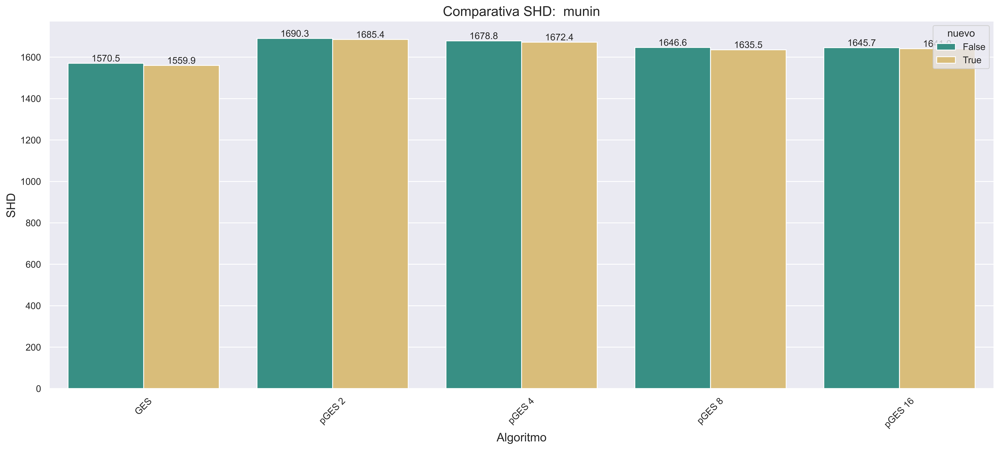

In [438]:
plot("munin", "SHD", 1, 11, True)

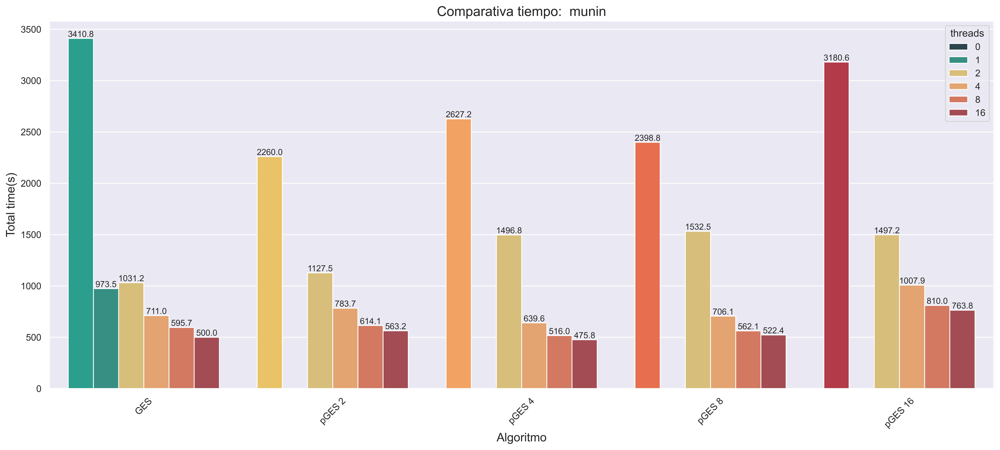

In [439]:
plot("munin",  "Total time(s)", 1, 10, True)